In [1]:
import glob
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=600, facecolor="white")

%load_ext lab_black

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.23.4 scipy==1.9.2 pandas==1.5.0 scikit-learn==1.1.2 statsmodels==0.13.2 python-igraph==0.10.1 pynndescent==0.5.7


In [2]:
def histogram(array, nbins=100):
    """
    Draw histogram from distribution and identify centers.
    Parameters
    ---------
    array: `class::np.array`
            Scores distribution
    nbins: int
            Number of bins to use in the histogram
    Return
    ---------
    float
            Histogram values and bin centers.
    """
    array = array.ravel().flatten()
    hist, bin_edges = np.histogram(array, bins=nbins, range=None)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2.0
    return hist, bin_centers


def threshold_otsu(array, nbins=100, min_value=100):
    """
    Apply Otsu threshold on topic-region distributions [Otsu, 1979].
    Parameters
    ---------
    array: `class::np.array`
            Array containing the region values for the topic to be binarized.
    nbins: int
            Number of bins to use in the binarization histogram
    Return
    ---------
    float
            Binarization threshold.
    Reference
    ---------
    Otsu, N., 1979. A threshold selection method from gray-level histograms. IEEE transactions on systems, man, and
    cybernetics, 9(1), pp.62-66.
    """
    array = array[(array >= min_value)]
    hist, bin_centers = histogram(array, nbins)
    hist = hist.astype(float)
    # Class probabilities for all possible thresholds
    weight1 = np.cumsum(hist)
    weight2 = np.cumsum(hist[::-1])[::-1]
    # Class means for all possible thresholds
    mean1 = np.cumsum(hist * bin_centers) / weight1
    mean2 = (np.cumsum((hist * bin_centers)[::-1]) / weight2[::-1])[::-1]
    # Clip ends to align class 1 and class 2 variables:
    # The last value of ``weight1``/``mean1`` should pair with zero values in
    # ``weight2``/``mean2``, which do not exist.
    variance12 = weight1[:-1] * weight2[1:] * (mean1[:-1] - mean2[1:]) ** 2
    idx = np.argmax(variance12)
    threshold = bin_centers[:-1][idx]
    return threshold

In [3]:
dir_dict = {
    x.split("/")[0]: x
    for x in sorted(glob.glob("*multiome*/outs/raw_feature_bc_matrix/"))
}
dir_dict

{'CNA_10xmultiome_1': 'CNA_10xmultiome_1/outs/raw_feature_bc_matrix/',
 'CNA_10xmultiome_2': 'CNA_10xmultiome_2/outs/raw_feature_bc_matrix/',
 'SAN_10xmultiome_1': 'SAN_10xmultiome_1/outs/raw_feature_bc_matrix/',
 'SAN_10xmultiome_2': 'SAN_10xmultiome_2/outs/raw_feature_bc_matrix/',
 'VIB_10xmultiome_1': 'VIB_10xmultiome_1/outs/raw_feature_bc_matrix/',
 'VIB_10xmultiome_2': 'VIB_10xmultiome_2/outs/raw_feature_bc_matrix/'}

In [4]:
min_x_val = 50  # for otsu

In [5]:
for sample, directory in dir_dict.items():
    print(sample)

    adata = sc.read_10x_mtx(
        dir_dict[sample],  # the directory with the `.mtx` file
        var_names="gene_symbols",  # use gene symbols for the variable names (variables-axis index)
        cache=True,
    )

    # adata.var_names_make_unique()
    adata.var["mt"] = adata.var_names.str.startswith(
        "MT-"
    )  # annotate the group of mitochondrial genes as 'mt'
    sc.pp.calculate_qc_metrics(
        adata, qc_vars=["mt"], percent_top=None, log1p=False, inplace=True
    )

    sc.pp.filter_cells(adata, min_genes=5)
    adata.obs = adata.obs.sort_values("total_counts", ascending=False)
    sc.pp.filter_genes(adata, min_cells=3)
    adata.obs["rank"] = range(len(adata.obs))
    adata.obs["rank"] = adata.obs["rank"] + 1

    arr = np.log10(adata.obs["total_counts"])
    threshold_log = threshold_otsu(arr, nbins=5000, min_value=np.log10(min_x_val))
    threshold = int(10**threshold_log)

    threshold_rank = adata.obs[adata.obs["total_counts"] >= threshold]["rank"].max()

    fig, ax = plt.subplots(figsize=(10, 5))
    sns.scatterplot(data=adata.obs, x="rank", y="total_counts", linewidth=0, ax=ax)
    ax.hlines(y=threshold, xmin=1, xmax=1000000)
    ax.vlines(x=threshold_rank, ymin=1, ymax=1000000)
    ax.set_xscale("log")
    ax.set_yscale("log")
    ax.set_xlim([1, 1000000])
    plt.title(f"{sample} {threshold_rank} cells, minimum {threshold} counts")

    plt.savefig(f"plots/{sample}_kneeplot.svg", dpi=300, facecolor="white")
    plt.savefig(f"plots/{sample}_kneeplot.png", dpi=300, facecolor="white")

    plt.show()

    adata.obs[adata.obs["total_counts"] >= threshold].to_csv(
        f"rna_qc/{sample}__adata.obs.tsv", sep="\t", index=True, header=True
    )

CNA_10xmultiome_1
... reading from cache file cache/CNA_10xmultiome_1-outs-raw_feature_bc_matrix-matrix.h5ad
filtered out 454565 cells that have less than 5 genes expressed
filtered out 11029 genes that are detected in less than 3 cells


CNA_10xmultiome_2
... reading from cache file cache/CNA_10xmultiome_2-outs-raw_feature_bc_matrix-matrix.h5ad
filtered out 454531 cells that have less than 5 genes expressed
filtered out 11040 genes that are detected in less than 3 cells


SAN_10xmultiome_1
... reading from cache file cache/SAN_10xmultiome_1-outs-raw_feature_bc_matrix-matrix.h5ad
filtered out 594292 cells that have less than 5 genes expressed
filtered out 14559 genes that are detected in less than 3 cells


SAN_10xmultiome_2
... reading from cache file cache/SAN_10xmultiome_2-outs-raw_feature_bc_matrix-matrix.h5ad
filtered out 597541 cells that have less than 5 genes expressed
filtered out 14275 genes that are detected in less than 3 cells


VIB_10xmultiome_1
... reading from cache file cache/VIB_10xmultiome_1-outs-raw_feature_bc_matrix-matrix.h5ad
filtered out 552714 cells that have less than 5 genes expressed
filtered out 16755 genes that are detected in less than 3 cells


VIB_10xmultiome_2
... reading from cache file cache/VIB_10xmultiome_2-outs-raw_feature_bc_matrix-matrix.h5ad
filtered out 557028 cells that have less than 5 genes expressed
filtered out 15388 genes that are detected in less than 3 cells


# compare with multiome barcodes

In [6]:
bc_atac = list(
    pd.read_csv(
        "/lustre1/project/res_00001/barcodes/cellranger_arc_atac.737K-arc-v1.REV_COMP.txt",
        header=None,
    )[0]
)
bc_rna = list(
    pd.read_csv(
        "/lustre1/project/res_00001/barcodes/cellranger_arc_rna.737K-arc-v1.txt",
        header=None,
    )[0]
)

atac2rna = {bc1: bc2 for bc1, bc2 in zip(bc_atac, bc_rna)}
rna2atac = {bc1: bc2 for bc1, bc2 in zip(bc_rna, bc_atac)}

rna2atac_revcomp = {bc1: bc2 for bc1, bc2 in zip(bc_rna, bc_atac)}

In [7]:
selected_barcodes_path_dict = {
    x.split("/")[-1].split(".")[0]: x
    for x in sorted(
        glob.glob("../full_2_cistopic/selected_barcodes/*multiome**RAW.txt")
    )
}
selected_barcodes_path_dict

{'CNA_10xmultiome_1': '../full_2_cistopic/selected_barcodes/CNA_10xmultiome_1.FULL_bc_passing_filters_otsu.RAW.txt',
 'CNA_10xmultiome_2': '../full_2_cistopic/selected_barcodes/CNA_10xmultiome_2.FULL_bc_passing_filters_otsu.RAW.txt',
 'SAN_10xmultiome_1': '../full_2_cistopic/selected_barcodes/SAN_10xmultiome_1.FULL_bc_passing_filters_otsu.RAW.txt',
 'SAN_10xmultiome_2': '../full_2_cistopic/selected_barcodes/SAN_10xmultiome_2.FULL_bc_passing_filters_otsu.RAW.txt',
 'VIB_10xmultiome_1': '../full_2_cistopic/selected_barcodes/VIB_10xmultiome_1.FULL_bc_passing_filters_otsu.RAW.txt',
 'VIB_10xmultiome_2': '../full_2_cistopic/selected_barcodes/VIB_10xmultiome_2.FULL_bc_passing_filters_otsu.RAW.txt'}

In [8]:
import os

In [9]:
for sample, directory in dir_dict.items():
    print(sample)
    if not os.path.exists(f"{sample}_adata_obs.tsv"):
        adata = sc.read_10x_mtx(
            dir_dict[sample],  # the directory with the `.mtx` file
            var_names="gene_symbols",  # use gene symbols for the variable names (variables-axis index)
            cache=True,
        )
        adata.var["mt"] = adata.var_names.str.startswith(
            "MT-"
        )  # annotate the group of mitochondrial genes as 'mt'
        sc.pp.calculate_qc_metrics(
            adata, qc_vars=["mt"], percent_top=None, log1p=False, inplace=True
        )
        adata.obs.to_csv(f"{sample}_adata_obs.tsv", sep="\t", header=True, index=True)

CNA_10xmultiome_1
CNA_10xmultiome_2
SAN_10xmultiome_1
SAN_10xmultiome_2
VIB_10xmultiome_1
VIB_10xmultiome_2


In [10]:
def reverse_complement(dna):
    complement = {"A": "T", "C": "G", "G": "C", "T": "A", "_": "_"}
    return "".join([complement[base] for base in reversed(dna)])

In [11]:
import os

# Initialize a dictionary to store the overlap statistics
overlap_stats = {}

for path in sorted(glob.glob("*_adata_obs.tsv")):
    # Get the sample name using os.path.basename()
    sample = os.path.basename(path).split("_adata_obs")[0]
    print(sample)

    # Load the rna-seq data and modify the index
    adata_df = pd.read_csv(path, index_col=0, sep="\t")

    rna_index = [
        x.replace(x.split("-")[0], rna2atac.get(x.split("-")[0], "test")).split("-")[0]
        for x in adata_df.index
    ]
    if sample.startswith("SAN_10xmultiome"):
        print("rc")
        rna_index = [reverse_complement(x) for x in rna_index]

    adata_df.index = rna_index

    # Load the selected barcodes and compute the overlap
    df = pd.read_csv(selected_barcodes_path_dict[sample], header=None, index_col=0)
    overlap_atac_rna = set(df.index) & set(rna_index)
    n_bc_in_atac = len(df)

    # Compute and store the overlap statistics
    frac_atac_barcodes_retrieved_in_rna = len(overlap_atac_rna) / n_bc_in_atac
    overlap_stats[sample] = {
        "num_overlap_barcodes": len(overlap_atac_rna),
        "frac_atac_barcodes_retrieved_in_rna": frac_atac_barcodes_retrieved_in_rna,
    }
    print(frac_atac_barcodes_retrieved_in_rna)
    if frac_atac_barcodes_retrieved_in_rna < 0.1:
        reverse_complement

    # Subset the ATAC-seq data and write to file
    adata_df_subset = adata_df.loc[list(overlap_atac_rna)]
    adata_df_subset.to_csv(
        f"{sample}_adata_overlap_obs.tsv", sep="\t", header=True, index=True
    )

# Print the overlap statistics
print(overlap_stats)

CNA_10xmultiome_1
0.9997172745264349
CNA_10xmultiome_2
1.0
SAN_10xmultiome_1
rc
0.9994274262811337
SAN_10xmultiome_2
rc
1.0
VIB_10xmultiome_1
0.9975747776879548
VIB_10xmultiome_2
0.9964699949571356
{'CNA_10xmultiome_1': {'num_overlap_barcodes': 3536, 'frac_atac_barcodes_retrieved_in_rna': 0.9997172745264349}, 'CNA_10xmultiome_2': {'num_overlap_barcodes': 3123, 'frac_atac_barcodes_retrieved_in_rna': 1.0}, 'SAN_10xmultiome_1': {'num_overlap_barcodes': 3491, 'frac_atac_barcodes_retrieved_in_rna': 0.9994274262811337}, 'SAN_10xmultiome_2': {'num_overlap_barcodes': 4270, 'frac_atac_barcodes_retrieved_in_rna': 1.0}, 'VIB_10xmultiome_1': {'num_overlap_barcodes': 1234, 'frac_atac_barcodes_retrieved_in_rna': 0.9975747776879548}, 'VIB_10xmultiome_2': {'num_overlap_barcodes': 1976, 'frac_atac_barcodes_retrieved_in_rna': 0.9964699949571356}}


# compar to atac

In [12]:
import os

metadata_path_dict = {
    os.path.basename(x).split(".")[0]: x
    for x in sorted(
        glob.glob(
            "../fixedcells_3_cistopic_consensus/cistopic_objects/*consensus*cell_data*tsv"
        )
    )
}
metadata_path_dict

{'BIO_ddseq_1': '../fixedcells_3_cistopic_consensus/cistopic_objects/BIO_ddseq_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.cell_data.tsv',
 'BIO_ddseq_2': '../fixedcells_3_cistopic_consensus/cistopic_objects/BIO_ddseq_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_14topics.dimreduc.consensus.cell_data.tsv',
 'BIO_ddseq_3': '../fixedcells_3_cistopic_consensus/cistopic_objects/BIO_ddseq_3.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.cell_data.tsv',
 'BIO_ddseq_4': '../fixedcells_3_cistopic_consensus/cistopic_objects/BIO_ddseq_4.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.cell_data.tsv',
 'BRO_mtscatac_1': '../fixedcells_3_cistopic_consensus/cistopic_objects/BRO_mtscatac_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.cell_data.tsv',
 'BRO_mtscatac_2': '../fixedcells_3_cistopic_consensus/cistopic_objects/BRO_mtscatac_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_

In [13]:
df_atac_cat = pd.DataFrame()
for path in sorted(glob.glob("*_adata_overlap_obs.tsv")):
    sample = os.path.basename(path).split("_adata_overlap_obs")[0]
    df_rna = pd.read_csv(path, sep="\t", index_col=0)
    print(len(df_rna))
    df_atac = pd.read_csv(metadata_path_dict[sample], sep=",", index_col=0)
    print(
        "\t"
        + str(len(set([x.split("___")[0] for x in df_atac.index]) & set(df_rna.index)))
    )
    index_old = df_atac.index
    df_atac.index = [x.split("___")[0] for x in df_atac.index]
    for col in df_rna.columns:
        df_atac[col] = df_rna[col]

    df_atac.index = index_old

    df_atac_cat = pd.concat([df_atac_cat, df_atac])

3536
	3290
3123
	2956
3491
	3160
4270
	3896
1234
	1193
1976
	1913


In [14]:
df_atac_cat["log_total_counts"] = np.log10(df_atac_cat["total_counts"])

/opt/venv/lib/python3.8/site-packages/pandas/core/arraylike.py:405: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


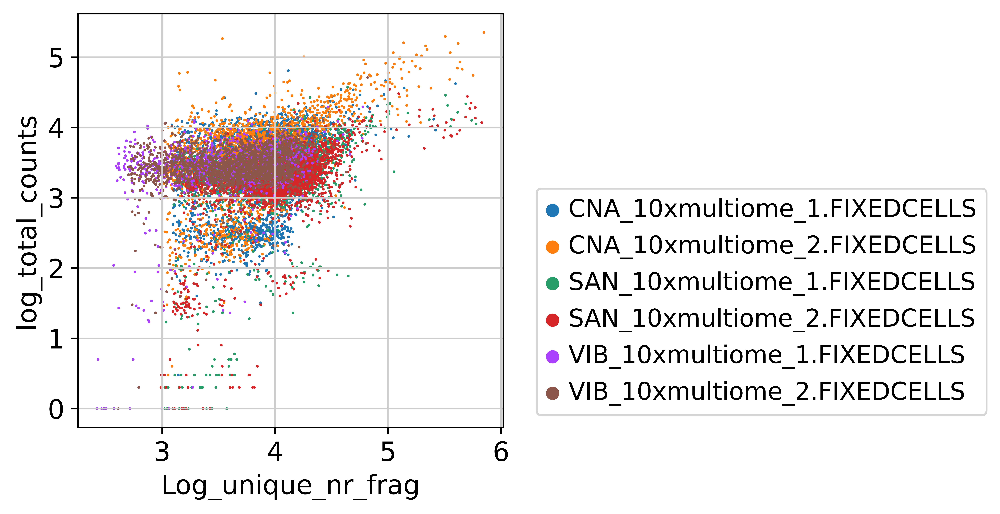

In [15]:
fig, ax = plt.subplots(figsize=(4, 4))
sns.scatterplot(
    data=df_atac_cat,
    x="Log_unique_nr_frag",
    y="log_total_counts",
    hue="sample_id",
    linewidth=0,
    s=2,
    ax=ax,
)

# Put a legend to the right of the current axis
ax.legend(loc="lower left", bbox_to_anchor=(1.05, 0))

# now try another strategy: take all rna-filtered cells, and all atac-filtered cells combined and plot the superset

In [16]:
adata_path_dict = {
    x.split("_adata")[0]: x for x in sorted(glob.glob("*_adata_obs.tsv"))
}

In [17]:
metadata_path_dict = {
    os.path.basename(x).split(".")[0]: x
    for x in sorted(
        glob.glob(
            "../fixedcells_3_cistopic_consensus/cistopic_objects/*consensus*cell_data*tsv"
        )
    )
}
metadata_path_dict

{'BIO_ddseq_1': '../fixedcells_3_cistopic_consensus/cistopic_objects/BIO_ddseq_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.cell_data.tsv',
 'BIO_ddseq_2': '../fixedcells_3_cistopic_consensus/cistopic_objects/BIO_ddseq_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_14topics.dimreduc.consensus.cell_data.tsv',
 'BIO_ddseq_3': '../fixedcells_3_cistopic_consensus/cistopic_objects/BIO_ddseq_3.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.cell_data.tsv',
 'BIO_ddseq_4': '../fixedcells_3_cistopic_consensus/cistopic_objects/BIO_ddseq_4.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.cell_data.tsv',
 'BRO_mtscatac_1': '../fixedcells_3_cistopic_consensus/cistopic_objects/BRO_mtscatac_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.cell_data.tsv',
 'BRO_mtscatac_2': '../fixedcells_3_cistopic_consensus/cistopic_objects/BRO_mtscatac_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_

In [18]:
metadata_pkl_path_dict = {
    os.path.basename(x).split(".")[0]: x
    for x in sorted(
        glob.glob(
            "../fixedcells_3_cistopic_consensus/cistopic_qc_out_CONSENSUS/*metadata*"
        )
    )
}
metadata_pkl_path_dict

{'BIO_ddseq_1': '../fixedcells_3_cistopic_consensus/cistopic_qc_out_CONSENSUS/BIO_ddseq_1.FIXEDCELLS__metadata_bc.pkl',
 'BIO_ddseq_2': '../fixedcells_3_cistopic_consensus/cistopic_qc_out_CONSENSUS/BIO_ddseq_2.FIXEDCELLS__metadata_bc.pkl',
 'BIO_ddseq_3': '../fixedcells_3_cistopic_consensus/cistopic_qc_out_CONSENSUS/BIO_ddseq_3.FIXEDCELLS__metadata_bc.pkl',
 'BIO_ddseq_4': '../fixedcells_3_cistopic_consensus/cistopic_qc_out_CONSENSUS/BIO_ddseq_4.FIXEDCELLS__metadata_bc.pkl',
 'BRO_mtscatac_1': '../fixedcells_3_cistopic_consensus/cistopic_qc_out_CONSENSUS/BRO_mtscatac_1.FIXEDCELLS__metadata_bc.pkl',
 'BRO_mtscatac_2': '../fixedcells_3_cistopic_consensus/cistopic_qc_out_CONSENSUS/BRO_mtscatac_2.FIXEDCELLS__metadata_bc.pkl',
 'CNA_10xmultiome_1': '../fixedcells_3_cistopic_consensus/cistopic_qc_out_CONSENSUS/CNA_10xmultiome_1.FIXEDCELLS__metadata_bc.pkl',
 'CNA_10xmultiome_2': '../fixedcells_3_cistopic_consensus/cistopic_qc_out_CONSENSUS/CNA_10xmultiome_2.FIXEDCELLS__metadata_bc.pkl',
 'CN

In [19]:
import pickle

In [21]:
df_cell_counts = pd.DataFrame()
for path in sorted(glob.glob("../full_5_cellranger/rna_qc/*multiome*")):
    sample = os.path.basename(path).split("__")[0]
    print(sample)
    df_rna = pd.read_csv(path, sep="\t", index_col=0)
    df_cell_counts.at[sample, "rna_cells"] = len(df_rna)
    rna_index = [
        x.replace(
            x.split("-")[0], rna2atac.get(x.split("-")[0], x.split("-")[0])
        ).split("-")[0]
        for x in df_rna.index
    ]
    if sample.startswith("SAN_10xmultiome"):
        # print("rc")
        rna_index = [reverse_complement(x) for x in rna_index]

    df_rna.index = rna_index

    df_atac = pd.read_csv(metadata_path_dict[sample], sep=",", index_col=0)
    df_cell_counts.at[sample, "atac_cells"] = len(df_atac)

    index_old = df_atac.index
    df_atac.index = [x.split("___")[0] for x in df_atac.index]

    all_barcodes = set(df_rna.index).union(set(df_atac.index))
    print(f"total barcodes: {len(all_barcodes)}")
    df_cell_counts.at[sample, "all_cells"] = len(all_barcodes)
    common_barcodes = set(df_rna.index) & set(df_atac.index)
    df_cell_counts.at[sample, "common_cells"] = len(common_barcodes)

    # now subset full datasets to these barcodes
    # start with rna data
    df_rna_full = pd.read_csv(adata_path_dict[sample], index_col=0, sep="\t")
    if sample.startswith("SAN_10xmultiome"):
        all_barcodes_rc = [
            atac2rna.get(reverse_complement(x), x.split("-")[0]) + "-1"
            for x in all_barcodes
        ]
        overlap = set(all_barcodes_rc) & set(df_rna_full.index)
    else:
        overlap = set(
            [atac2rna.get(x, x.split("-")[0]) + "-1" for x in all_barcodes]
        ) & set(df_rna_full.index)

    frac_overlap = len(overlap) / len(all_barcodes)
    print(f"n in rna: {len(overlap)}")
    print(f"frac in rna: {frac_overlap}")

    df_rna_subset = df_rna_full.loc[list(overlap)]

    df_rna_subset.index = [
        x.replace(
            x.split("-")[0], rna2atac.get(x.split("-")[0], x.split("-")[0])
        ).split("-")[0]
        for x in df_rna_subset.index
    ]
    if sample.startswith("SAN_10xmultiome"):
        df_rna_subset.index = [reverse_complement(x) for x in df_rna_subset.index]

    # then atac data:
    with open(metadata_pkl_path_dict[sample], "rb") as f:
        df_atac_full = pickle.load(f)

    index_old = df_atac_full.index
    df_atac_full.index = [x.split("___")[0] for x in df_atac_full.index]
    overlap = set(all_barcodes) & set(df_atac_full.index)
    frac_overlap = len(overlap) / len(all_barcodes)

    df_atac_subset = df_atac_full.loc[list(overlap)]
    print(f"n in atac: {len(df_atac_subset)}")
    print(f"frac in atac: {frac_overlap}")

    df_merged = df_atac_subset.join(df_rna_subset, how="outer")
    df_merged.to_csv(f"{sample}_df_merged.tsv", sep="\t", index=True, header=True)

CNA_10xmultiome_1
total barcodes: 7228
n in rna: 7227
frac in rna: 0.9998616491422246
n in atac: 4974
frac in atac: 0.6881571665744327
CNA_10xmultiome_2
total barcodes: 6952
n in rna: 6952
frac in rna: 1.0
n in atac: 4786
frac in atac: 0.6884349827387802
SAN_10xmultiome_1
total barcodes: 3722
n in rna: 3721
frac in rna: 0.9997313272434175
n in atac: 3720
frac in atac: 0.999462654486835
SAN_10xmultiome_2
total barcodes: 4607
n in rna: 4607
frac in rna: 1.0
n in atac: 4606
frac in atac: 0.9997829390058607
VIB_10xmultiome_1
total barcodes: 1402
n in rna: 1399
frac in rna: 0.9978601997146933
n in atac: 1394
frac in atac: 0.9942938659058488
VIB_10xmultiome_2
total barcodes: 2285
n in rna: 2278
frac in rna: 0.9969365426695842
n in atac: 2269
frac in atac: 0.9929978118161925


In [22]:
df_cell_counts.to_csv("cell_counts.csv", index=True, header=True)

# plot final

In [23]:
import os

df_cat = pd.DataFrame()
for path in sorted(glob.glob("*_df_merged.tsv")):
    sample = os.path.basename(path).split("_df_merged")[0]
    df = pd.read_csv(path, sep="\t", index_col=0)
    df["sample"] = sample
    df.index = [x + f"__{sample}" for x in df.index]

    df_cat = pd.concat([df_cat, df])

In [24]:
df_cat["sample"].value_counts()

CNA_10xmultiome_1    7228
CNA_10xmultiome_2    6952
SAN_10xmultiome_2    4607
SAN_10xmultiome_1    3722
VIB_10xmultiome_2    2285
VIB_10xmultiome_1    1402
Name: sample, dtype: int64

In [25]:
df_cat["Unique_nr_frag_in_regions"] = df_cat["Unique_nr_frag_in_regions"].fillna(1)
df_cat["Log_unique_nr_frag_in_regions"] = np.log10(df_cat["Unique_nr_frag_in_regions"])

/opt/venv/lib/python3.8/site-packages/pandas/core/arraylike.py:405: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [26]:
df_cat["n_genes_by_counts"] = df_cat["n_genes_by_counts"].fillna(1)
df_cat["log_n_genes_by_counts"] = np.log10(df_cat["n_genes_by_counts"].fillna(1))

/opt/venv/lib/python3.8/site-packages/pandas/core/arraylike.py:405: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [27]:
df_cat["total_counts"] = df_cat["total_counts"].fillna(1)
df_cat["log_total_counts"] = np.log10(df_cat["total_counts"].fillna(1))

/opt/venv/lib/python3.8/site-packages/pandas/core/arraylike.py:405: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [28]:
df_cat["sample"].unique()

array(['CNA_10xmultiome_1', 'CNA_10xmultiome_2', 'SAN_10xmultiome_1',
       'SAN_10xmultiome_2', 'VIB_10xmultiome_1', 'VIB_10xmultiome_2'],
      dtype=object)

In [29]:
sample_id_ultrashort_alias_dict = {
    "BIO_ddseq_1.FIXEDCELLS": "ddS Bi1",
    "BIO_ddseq_2.FIXEDCELLS": "ddS Bi2",
    "BIO_ddseq_3.FIXEDCELLS": "ddS Bi3",
    "BIO_ddseq_4.FIXEDCELLS": "ddS Bi4",
    "BRO_mtscatacfacs_1.FIXEDCELLS": "mt* Br1",
    "BRO_mtscatacfacs_2.FIXEDCELLS": "mt* Br2",
    "CNA_10xmultiome_1.FIXEDCELLS": "MO C1",
    "CNA_10xmultiome_2.FIXEDCELLS": "MO C2",
    "CNA_10xv11_1.FIXEDCELLS": "v1.1 C1",
    "CNA_10xv11_2.FIXEDCELLS": "v1.1 C2",
    "CNA_10xv11_3.FIXEDCELLS": "v1.1 C3",
    "CNA_10xv11c_1.FIXEDCELLS": "v1.1c C1",
    "CNA_10xv11c_2.FIXEDCELLS": "v1.1c C2",
    "CNA_10xv2_1.FIXEDCELLS": "v2 C1",
    "CNA_10xv2_2.FIXEDCELLS": "v2 C2",
    "CNA_hydrop_1.FIXEDCELLS": "Hy C1",
    "CNA_hydrop_2.FIXEDCELLS": "Hy C2",
    "CNA_hydrop_3.FIXEDCELLS": "Hy C3",
    "CNA_mtscatac_1.FIXEDCELLS": "mt C1",
    "CNA_mtscatac_2.FIXEDCELLS": "mt C2",
    "EPF_hydrop_1.FIXEDCELLS": "Hy E1",
    "EPF_hydrop_2.FIXEDCELLS": "Hy E2",
    "EPF_hydrop_3.FIXEDCELLS": "Hy E3",
    "EPF_hydrop_4.FIXEDCELLS": "Hy E4",
    "HAR_ddseq_1.FIXEDCELLS": "ddS H1",
    "HAR_ddseq_2.FIXEDCELLS": "ddS H2",
    "MDC_mtscatac_1.FIXEDCELLS": "mt M1",
    "MDC_mtscatac_2.FIXEDCELLS": "mt M2",
    "OHS_s3atac_1.FIXEDCELLS": "s3 O1",
    "OHS_s3atac_2.FIXEDCELLS": "s3 O2",
    "SAN_10xmultiome_1.FIXEDCELLS": "MO Sa1",
    "SAN_10xmultiome_2.FIXEDCELLS": "MO Sa2",
    "STA_10xv11_1.FIXEDCELLS": "v1.1 St1",
    "STA_10xv11_2.FIXEDCELLS": "v1.1 St2",
    "TXG_10xv11_1.FIXEDCELLS": "v1.1 T1",
    "TXG_10xv2_1.FIXEDCELLS": "v2 T1",
    "TXG_10xv2_2.FIXEDCELLS": "v2 T2",
    "UCS_ddseq_1.FIXEDCELLS": "ddS U1",
    "UCS_ddseq_2.FIXEDCELLS": "ddS U2",
    "VIB_10xmultiome_1.FIXEDCELLS": "MO V1",
    "VIB_10xmultiome_2.FIXEDCELLS": "MO V2",
    "VIB_10xv1_1.FIXEDCELLS": "v1 V1",
    "VIB_10xv1_2.FIXEDCELLS": "v1 V2",
    "VIB_10xv2_1.FIXEDCELLS": "v2 V1",
    "VIB_10xv2_2.FIXEDCELLS": "v2 V2",
    "VIB_hydrop_1.FIXEDCELLS": "Hy V1",
    "VIB_hydrop_2.FIXEDCELLS": "Hy V2",
    "VIB_hydrop_11.FIXEDCELLS": "Hy V1",
    "VIB_hydrop_12.FIXEDCELLS": "Hy V1",
    "VIB_hydrop_21.FIXEDCELLS": "Hy V2",
    "VIB_hydrop_22.FIXEDCELLS": "Hy V2",
}

In [30]:
df_cat["sample_short"] = [
    sample_id_ultrashort_alias_dict[x + ".FIXEDCELLS"] for x in df_cat["sample"]
]

Text(0, 0.5, 'Genes')

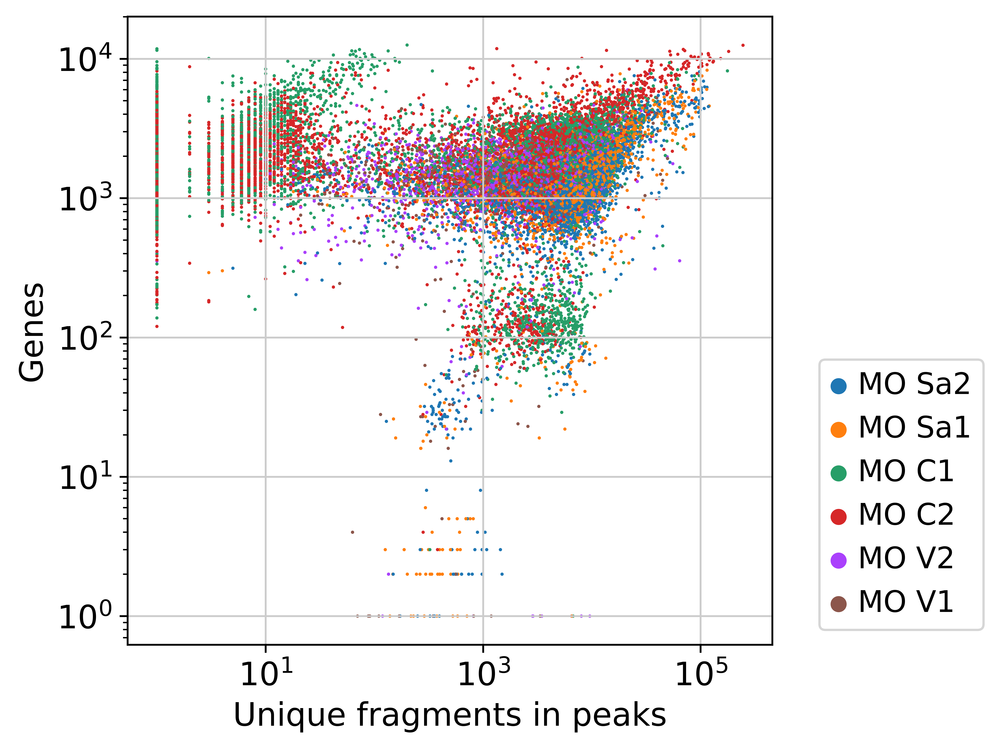

In [31]:
fig, ax = plt.subplots(figsize=(5, 5))
sns.scatterplot(
    data=df_cat.sample(frac=1),
    x="Unique_nr_frag_in_regions",
    y="n_genes_by_counts",
    hue="sample_short",
    ax=ax,
    s=2,
    linewidth=0,
)
ax.set_xscale("log")
ax.set_yscale("log")


ax.legend(loc="lower left", bbox_to_anchor=(1.05, 0))
ax.set_xlabel("Unique fragments in peaks")
ax.set_ylabel("Genes")

In [ ]:
fig, ax = plt.subplots(figsize=(5, 5))
sns.scatterplot(
    data=df_cat,
    x="Unique_nr_frag_in_regions",
    y="total_counts",
    hue="sample_id",
    ax=ax,
    s=2,
    linewidth=0,
)
ax.set_xscale("log")
ax.set_yscale("log")

ax.legend(loc="lower left", bbox_to_anchor=(1.05, 0))

In [ ]:
fig, ax = plt.subplots(figsize=(5, 5))
sns.scatterplot(
    data=df_cat,
    x="Unique_nr_frag",
    y="total_counts",
    hue="sample_id",
    ax=ax,
    s=2,
    linewidth=0,
)
ax.set_xscale("log")
ax.set_yscale("log")

ax.legend(loc="lower left", bbox_to_anchor=(1.05, 0))

In [ ]:
df_cell_counts = pd.read_csv("cell_counts.csv", index_col=0)
df_cell_counts

,rna_cells,atac_cells,all_cells,common_cells
CNA_10xmultiome_1,6664.0,3291.0,7228.0,2727.0
CNA_10xmultiome_2,6661.0,2956.0,6952.0,2665.0
SAN_10xmultiome_1,3587.0,3161.0,3722.0,3026.0
SAN_10xmultiome_2,4445.0,3896.0,4607.0,3734.0
VIB_10xmultiome_1,1346.0,1196.0,1402.0,1140.0
VIB_10xmultiome_2,2241.0,1920.0,2285.0,1876.0


In [38]:
df_cat["n_genes_by_counts"] = df_cat["n_genes_by_counts"]
df_cat["log_n_genes_by_counts"] = np.log10(df_cat["n_genes_by_counts"].fillna(1))

In [39]:
import numpy as np
from scipy.stats import gaussian_kde

In [40]:
# library
import matplotlib.pyplot as plt

# from matplotlib_venn import venn2

fig, axes = plt.subplots(2, 3, figsize=(12, 6), sharex=True, sharey=True)
for sample in df_cell_counts.index:
    ax = axes.flatten()[list(df_cell_counts.index).index(sample)]
    print(ax)
    df_sub = df_cat[df_cat["sample"] == sample]

    x_log = np.log10((df_sub["Unique_nr_frag_in_regions"] + 1).fillna(1))
    y_log = np.log10((df_sub["n_genes_by_counts"] + 1).fillna(1))

    kde = gaussian_kde([x_log, y_log])
    df_sub["kde"] = kde([x_log, y_log])
    sns.scatterplot(
        data=df_sub,
        x="Unique_nr_frag_in_regions",
        y="n_genes_by_counts",
        hue="kde",
        palette="viridis",
        # hue="sample_short",
        ax=ax,
        s=2,
        linewidth=0,
    )
    ax.set_xscale("log")
    ax.set_yscale("log")
    ax.legend_.remove()
    # ax.legend(loc="lower left", bbox_to_anchor=(1.05, 0))
    ax.set_xlabel("Unique fragments in peaks")
    ax.set_ylabel("Genes")
    ax.title.set_text(sample_id_ultrashort_alias_dict[sample + ".FIXEDCELLS"])

plt.savefig(f"plots/scatterplots_combined.svg", dpi=300, facecolor="white")
plt.savefig(f"plots/scatterplots_combined.svg", dpi=300, facecolor="white")

# plt.show()

AxesSubplot(0.18,0.564545;0.229412x0.345455)


/tmp/ipykernel_2960551/2910049633.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sub["kde"] = kde([x_log, y_log])


AxesSubplot(0.455294,0.564545;0.229412x0.345455)


/tmp/ipykernel_2960551/2910049633.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sub["kde"] = kde([x_log, y_log])


AxesSubplot(0.730588,0.564545;0.229412x0.345455)


/tmp/ipykernel_2960551/2910049633.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sub["kde"] = kde([x_log, y_log])


AxesSubplot(0.18,0.15;0.229412x0.345455)


/tmp/ipykernel_2960551/2910049633.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sub["kde"] = kde([x_log, y_log])
/tmp/ipykernel_2960551/2910049633.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sub["kde"] = kde([x_log, y_log])


AxesSubplot(0.455294,0.15;0.229412x0.345455)
AxesSubplot(0.730588,0.15;0.229412x0.345455)


/tmp/ipykernel_2960551/2910049633.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sub["kde"] = kde([x_log, y_log])
